# BARRA <> DEA example notebook

This is a prototype notebook demonstrating the use of BARRA reanalysis data, specifically
the BARRA-R^1 'accum_prcp'^2 variable.

To be able to execute this notebook, you will need to have completed a "licence schedule" outlining
the usage rights to BARRA data, as well as requesting access to the NCI project 'ma05'.

1 - BARRA domain representing Australian continent <br />
2 - hourly accumulated precipitation including rainfall and snowfall

For more information on BARRA and the data used in this notebook, please see:

In [30]:
import datacube
import rasterio
import time
import os
import numpy as np
from datacube.helpers import write_geotiff
from matplotlib import pyplot
from IPython.display import Image

import xarray as xr
import dea_plotting
import matplotlib.pyplot as plt

## Before loading BARRA data...

In [31]:
# you will need a datacube confing:
config = {
    'db_hostname': 'agdcdev-db.nci.org.au',
    'db_port': 6432,
    'db_database': 'dg6911'
}
dc = datacube.Datacube(config=config)

In [32]:
#roughly Australia
query = {}
query['latitude'] = (-44,-9)
query['longitude'] = (113,154)

## Querying BARRA data

In [33]:
# this paricular BARRA variable has hourly time steps

barra_datasets = dc.find_datasets(product='av_sfc_temp',time='1990')
print(len(barra_datasets))

barra_datasets = dc.find_datasets(product='av_sfc_temp',time='1990-01')
print(len(barra_datasets))

barra_datasets = dc.find_datasets(product='av_sfc_temp',time='1990-01-01')
print(len(barra_datasets))

barra_datasets = dc.find_datasets(product='av_sfc_temp',time='1990-01-01T00:00:00.0000Z')
print(len(barra_datasets))

8760
744
24
1


In [34]:
av_sfc_temp = dc.load(product='av_sfc_temp',
                     time='1990-01-01T00:00:00.0000Z', **query)

In [37]:
av_sfc_temp

<xarray.Dataset>
Dimensions:      (latitude: 319, longitude: 373, time: 1)
Coordinates:
  * time         (time) datetime64[ns] 1990-01-01T00:29:59.999999
  * latitude     (latitude) float64 -44.05 -43.94 -43.83 ... -9.175 -9.065
  * longitude    (longitude) float64 113.0 113.1 113.2 ... 153.7 153.8 153.9
Data variables:
    av_sfc_temp  (time, latitude, longitude) float64 283.9 283.8 ... 302.4 302.5
Attributes:
    crs:      GEOGCS["unknown",DATUM["unknown",SPHEROID["Sphere",6371229,0]],...

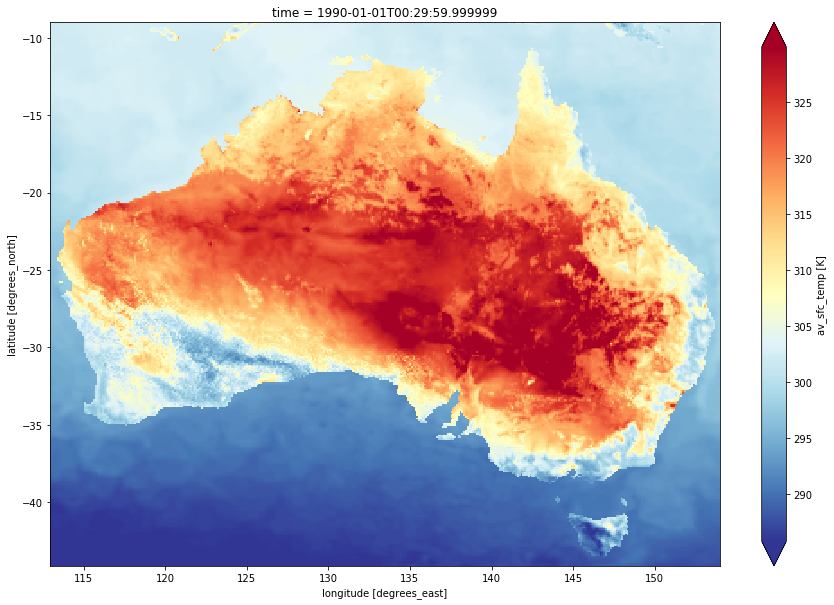

In [35]:
av_sfc_temp['av_sfc_temp'].squeeze().plot.imshow(cmap='RdYlBu_r', robust=True, size=10)

## Producing summaries

In [ ]:
%time  av_sfc_temp = dc.load(product='av_sfc_temp', time='1990-01-01', **query)

In [ ]:
maximum_temp = av_sfc_temp['av_sfc_temp'].max(dim='time')

In [ ]:
maximum_temp.plot.imshow(cmap='RdYlBu_r', size=10, robust=True)

In [ ]:
minimum_temp = av_sfc_temp['av_sfc_temp'].min(dim='time')

In [ ]:
minimum_temp.plot.imshow(cmap='RdYlBu_r', size=10, robust=True)

In [50]:
def flip_barra_data(source_dataset, target_variable='av_sfc_temp'):
    temp_dataarray = source_dataset[target_variable].reindex(latitude=source_dataset[target_variable].latitude[::-1])
    target_dataset = temp_dataarray.to_dataset()
    target_dataset.attrs = temp_dataarray.attrs
    return target_dataset

## Load BARRA faster using DASK

In [4]:
import dask
import dask.distributed

client = dask.distributed.Client(n_workers=8,
                                 threads_per_worker=1,
                                 memory_limit='3G',
                                 ip='127.0.0.1')
client

Client Scheduler: tcp://127.0.0.1:35099 Dashboard: http://127.0.0.1:8787/status,Cluster Workers: 8 Cores: 8 Memory: 24.00 GB


In [59]:
def calculate_daily_maximum_minimum(date):
    av_sfc_temp = dc.load(product='av_sfc_temp',
             dask_chunks={'time':6},
               time=date,
               skip_broken_datasets=True, **query)

    loaded_av_sfc_temp = av_sfc_temp['av_sfc_temp'].compute()
    maximum = loaded_av_sfc_temp.max(dim='time')- 273.15
    minimum = loaded_av_sfc_temp.min(dim='time')- 273.15
    
    
    
    latitude = loaded_av_sfc_temp.latitude
    longitude = loaded_av_sfc_temp.longitude
    attrs = loaded_av_sfc_temp.attrs
    coords = None
    dims = None
    coords = [latitude, longitude]
    dims = ['latitude', 'longitude']
    
    maximum_dataset = xr.Dataset({'av_sfc_temp': maximum}, coords={'latitude': latitude,'longitude': longitude,'time':date})
    maximum_dataset['av_sfc_temp'].attrs = attrs
    maximum_dataset.attrs = attrs
    
    minimum_dataset = xr.Dataset({'av_sfc_temp': minimum}, coords={'latitude': latitude,'longitude': longitude,'time':date})
    minimum_dataset['av_sfc_temp'].attrs = attrs
    minimum_dataset.attrs = attrs
    
    return flip_barra_data(maximum_dataset), flip_barra_data(minimum_dataset)

In [79]:
maximum_daily_dict = {}
minimum_daily_dict = {}
for day in range(1, 32):
    date = '1994-07-'+ f'{day:02}'
    maximum_daily_dict[date], minimum_daily_dict[date] = calculate_daily_maximum_minimum(date)
#combine sensors and sort by time
maximum_daily = xr.concat(maximum_daily_dict.values(), 'time')
maximum_daily = maximum_daily.sortby('time')

minimum_daily = xr.concat(minimum_daily_dict.values(), 'time')
minimum_daily = minimum_daily.sortby('time')

Generating 31 frame animation
    Exporting animation to july_maximum.gif


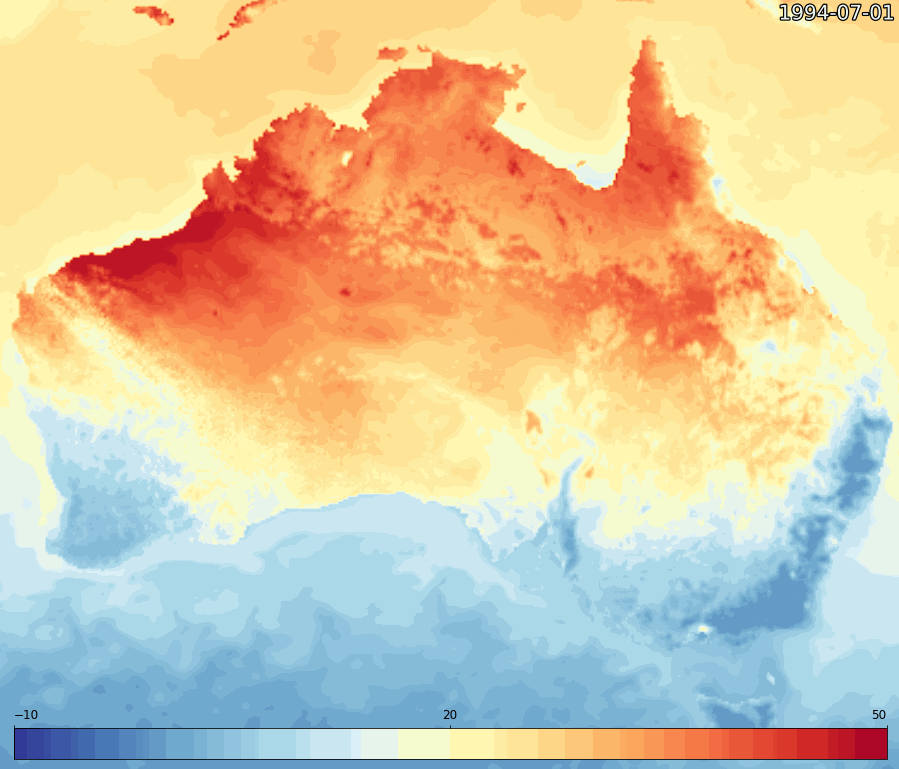

In [80]:
dea_plotting.animated_timeseries(ds=maximum_daily, output_path='july_maximum.gif',
                                width_pixels=900,
                                bands=['av_sfc_temp'],
                                title=False,
                                interval=200,
                                x_dim='longitude',
                                y_dim='latitude',
                                time_dim='time',
                                onebandplot_kwargs={'cmap':'RdYlBu_r','vmin':-10, 'vmax':50})
# Plot animated gif
plt.close()
Image(filename='july_maximum.gif')

Generating 31 frame animation
    Exporting animation to july_minimum.gif


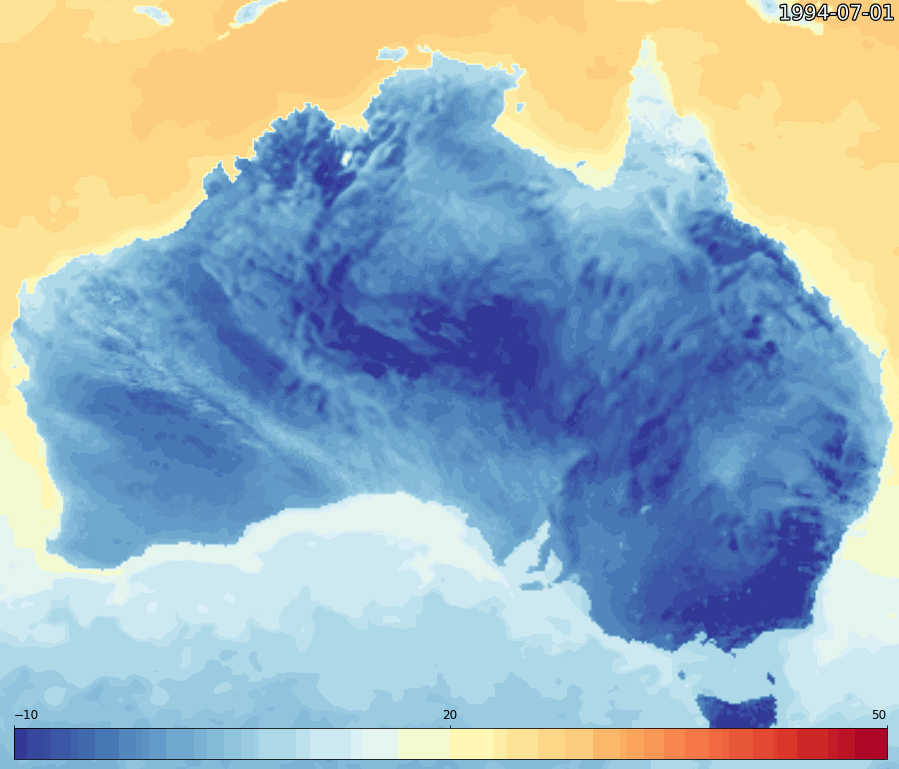

In [81]:
dea_plotting.animated_timeseries(ds=minimum_daily, output_path='july_minimum.gif',
                                width_pixels=900,
                                bands=['av_sfc_temp'],
                                title=False,
                                interval=200,
                                x_dim='longitude',
                                y_dim='latitude',
                                time_dim='time',
                                onebandplot_kwargs={'cmap':'RdYlBu_r','vmin':-10, 'vmax':50})
# Plot animated gif
plt.close()
Image(filename='july_minimum.gif')